# WGMS reference glaciers - standard projections plots 
### based on _10 minutes to..._ a glacier change projection with GCM data

In [1]:
# Libs
import xarray as xr
import matplotlib.pyplot as plt
import os
from os.path import join

# Locals
import oggm.cfg as cfg
from oggm import utils, workflow, tasks, DEFAULT_BASE_URL
from oggm.shop import gcm_climate

## Pre-processed directories

Let's do a run for two Himalayan glaciers: Ngojumba and Khumbu.

In [28]:
# glaciers chosen for visualization
glac_dict = {
    # Alaska
    "Wolverine Glacier": {
        "rgi_id": "RGI60-01.09162",
        "camera_params": {
            'azimuth': -135, # rotate around the z-axis
            'elevation': 20,  # elevation angle above ground
        },
        "fl_thickness_threshold": 1,
        "rolling_mean_smoothing": 3
    }, # check_geom: WARN:WasInvalid;
    # Arctic Canada North
    "White Glacier": {
        "rgi_id": "RGI60-03.04539",
        "camera_params": {
            'azimuth': -135, # rotate around the z-axis
                    'elevation': 20,  # elevation angle above ground
            },
        "fl_thickness_threshold": 1,
        "rolling_mean_smoothing": 3
        },
    # Svalbard
    "Austre Broeggerbreen": {
        "rgi_id": "RGI60-07.00504",
        "camera_params": {
            'azimuth': -135, # rotate around the z-axis
                    'elevation': 20,  # elevation angle above ground
            },
        "fl_thickness_threshold": 1,
        "rolling_mean_smoothing": 3
        },
    # Scandinavia
    "Nigardsbreen": {
        "rgi_id": "RGI60-08.01126",
        "camera_params": {
            'azimuth': -135, # rotate around the z-axis
                    'elevation': 20,  # elevation angle above ground
            },
        "fl_thickness_threshold": 1,
        "rolling_mean_smoothing": 3
        },
    # Central Europe
    "Pasterze": {
        "rgi_id": "RGI60-11.00106",
        "camera_params": {
            'azimuth': -135, # rotate around the z-axis
                    'elevation': 20,  # elevation angle above ground
            },
        "fl_thickness_threshold": 1,
        "rolling_mean_smoothing": 3
        },
    # Caucasus
    "Garabashi Glacier": {
        "rgi_id": "RGI60-12.00161",
        "camera_params": {
            'azimuth': -135, # rotate around the z-axis
                    'elevation': 20,  # elevation angle above ground
            },
        "fl_thickness_threshold": 1,
        "rolling_mean_smoothing": 3
        },
    # Central Asia
    "Golubin Glacier": {
        "rgi_id": "RGI60-13.11609",
        "camera_params": {
            'azimuth': -135, # rotate around the z-axis
                    'elevation': 20,  # elevation angle above ground
            },
        "fl_thickness_threshold": 1,
        "rolling_mean_smoothing": 3
        },
    # Southern Andes
    "Echaurren Norte": {
        "rgi_id":"RGI60-17.13715",
        "camera_params": {
            'azimuth': -135, # rotate around the z-axis
                    'elevation': 20,  # elevation angle above ground
            },
        "fl_thickness_threshold": 1,
        "rolling_mean_smoothing": 3
        }
}

glac_names = list(glac_dict.keys())
camera_params = [glacier["camera_params"] for glacier in glac_dict.values()]
rgi_ids = [glacier["rgi_id"] for glacier in glac_dict.values()]
flt_param = [glacier["fl_thickness_threshold"] for glacier in glac_dict.values()]
rms_param = [glacier["rolling_mean_smoothing"] for glacier in glac_dict.values()]

# maybe pass the whole dict and use retrieve the values in the loop, otherwise need to zip too many values


In [27]:
rms_param

[3, 3, 3, 3, 3, 3, 3, 3]

In [5]:
# Initialize OGGM and set up the default run parameters
cfg.initialize(logging_level='WARNING')

# Local working directory (where OGGM will write its output)
cfg.PATHS['working_dir'] = '/Users/afisc/atmo_master/rgi_job/oggm-3dviz/reference_glaciers_wd'



# Go - get the pre-processed glacier directories
# You have to explicitly indicate the url from where you want to start from
gdirs = workflow.init_glacier_directories(rgi_ids, from_prepro_level=4, prepro_base_url=DEFAULT_BASE_URL)

2024-07-03 17:05:50: oggm.cfg: Reading default parameters from the OGGM `params.cfg` configuration file.
2024-07-03 17:05:50: oggm.cfg: Multiprocessing switched OFF according to the parameter file.
2024-07-03 17:05:50: oggm.cfg: Multiprocessing: using all available processors (N=8)
2024-07-03 17:05:50: oggm.workflow: init_glacier_directories from prepro level 4 on 8 glaciers.
2024-07-03 17:05:50: oggm.workflow: Execute entity tasks [gdir_from_prepro] on 8 glaciers
2024-07-03 17:05:50: oggm.workflow: WARNING: you are trying to run an entity task on 8 glaciers with multiprocessing turned off. OGGM will run faster with multiprocessing turned on.


## The `_spinup_historical` runs

The level 5 files now come with a pre-computed model run from the RGI outline date to the last possible date given by the historical climate data. In case of the new default climate dataset [GSWP3_W5E5](https://www.isimip.org/gettingstarted/input-data-bias-adjustment/details/80/), this is until the end of 2019, so the volume is computed until January 1st, 2020. These files are stored in the directory with a `_spinup_historical` suffix (see the ["10 minutes to... a dynamical spinup"](dynamical_spinup.ipynb) tutorial for context).

Let's compile them into a single file for our two glaciers: 

2024-07-03 17:05:54: oggm.utils: Applying global task compile_run_output on 8 glaciers
2024-07-03 17:05:54: oggm.utils: Applying compile_run_output on 8 gdirs.


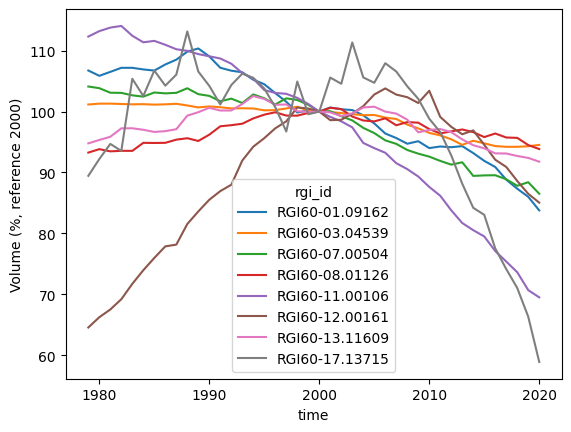

In [6]:
ds = utils.compile_run_output(gdirs, input_filesuffix='_spinup_historical')
(ds.volume / ds.volume.sel(time=2000) * 100).plot(hue='rgi_id');
plt.ylabel('Volume (%, reference 2000)');

In [7]:
ds

<xarray.Dataset> Size: 27kB
Dimensions:                   (time: 42, rgi_id: 8)
Coordinates:
  * time                      (time) float64 336B 1.979e+03 ... 2.02e+03
  * rgi_id                    (rgi_id) <U14 448B 'RGI60-01.09162' ... 'RGI60-...
    hydro_year                (time) int64 336B 1979 1980 1981 ... 2019 2020
    hydro_month               (time) int64 336B 4 4 4 4 4 4 4 ... 4 4 4 4 4 4 4
    calendar_year             (time) int64 336B 1979 1980 1981 ... 2019 2020
    calendar_month            (time) int64 336B 1 1 1 1 1 1 1 ... 1 1 1 1 1 1 1
Data variables:
    volume                    (time, rgi_id) float64 3kB 1.862e+09 ... 5.568e+06
    volume_bsl                (time, rgi_id) float64 3kB 0.0 8.064e+05 ... 0.0
    volume_bwl                (time, rgi_id) float64 3kB 0.0 8.064e+05 ... 0.0
    area                      (time, rgi_id) float64 3kB 1.689e+07 ... 3.252e+05
    area_m2_min_h             (time, rgi_id) float64 3kB 1.689e+07 ... 2.795e+05
    length                    (time, rgi_id) float64 3kB 7.638e+03 ... 720.0
    calving                   (time, rgi_id) float64 3kB 0.0 0.0 0.0 ... 0.0 0.0
    calving_rate              (time, rgi_id) float64 3kB 0.0 0.0 0.0 ... 0.0 0.0
    is_fixed_geometry_spinup  (time, rgi_id) float64 3kB 0.0 0.0 0.0 ... 0.0 0.0
    water_level               (rgi_id) float64 64B 0.0 0.0 0.0 ... 0.0 0.0 0.0
    glen_a                    (rgi_id) float64 64B 7.452e-24 ... 8.363e-24
    fs                        (rgi_id) float64 64B 0.0 0.0 0.0 ... 0.0 0.0 0.0
Attributes:
    description:    OGGM model output
    oggm_version:   1.6.2.dev35+g7489be1.d20240522
    calendar:       365-day no leap
    creation_date:  2024-07-03 15:05:55

Each RGI glacier has an "inventory date", the time at which the ouline is valid:

## wider spread of rgi_dates

In [8]:
gdirs[0].rgi_date, gdirs[1].rgi_date, gdirs[2].rgi_date, gdirs[3].rgi_date, gdirs[4].rgi_date, gdirs[5].rgi_date, gdirs[6].rgi_date, gdirs[7].rgi_date

(2006, 1999, 2007, 2006, 2003, 2000, 2000, 2000)

The glacier volume and area changes before that date are highly uncertain and serve the purpose of spinup only! In the ["10 minutes to... a dynamical spinup"](dynamical_spinup.ipynb) tutorial, we talk about why. For now, these files are perfect for our purpose, since we plan to start our simulation in 2020.

## Download and process GCM data from ISIMIP3b (bias-corrected CMIP6)

A typical use case for OGGM will be to use climate model output (here bias-corrected CMIP6 GCMs from [ISIMIP3b](https://www.isimip.org/gettingstarted/isimip3b-bias-adjustment/)). We use the files [we mirrored in Bremen](https://cluster.klima.uni-bremen.de/~oggm/cmip6/isimip3b/flat/monthly/) here, but you can use whichever you want. From ISIMIP3b, we have 5 GCMs and 3 SSPs on the cluster. You can find more information on the [ISIMIP website](https://www.isimip.org/gettingstarted/isimip3b-bias-adjustment). Let's download the data:

In [9]:
# you can choose one of these 5 different GCMs:
# 'gfdl-esm4_r1i1p1f1', 'mpi-esm1-2-hr_r1i1p1f1', 'mri-esm2-0_r1i1p1f1' ("low sensitivity" models, within typical ranges from AR6)
# 'ipsl-cm6a-lr_r1i1p1f1', 'ukesm1-0-ll_r1i1p1f2' ("hotter" models, especially ukesm1-0-ll)
member = 'mri-esm2-0_r1i1p1f1' 

for ssp in ['ssp126', 'ssp370','ssp585']:
    # bias correct them
    workflow.execute_entity_task(gcm_climate.process_monthly_isimip_data, gdirs, 
                                 ssp = ssp,
                                 # gcm member -> you can choose another one
                                 member=member,
                                 # recognize the climate file for later
                                 output_filesuffix=f'_ISIMIP3b_{member}_{ssp}',
                                 );

2024-07-03 17:05:55: oggm.workflow: Execute entity tasks [process_monthly_isimip_data] on 8 glaciers
2024-07-03 17:05:55: oggm.workflow: WARNING: you are trying to run an entity task on 8 glaciers with multiprocessing turned off. OGGM will run faster with multiprocessing turned on.
2024-07-03 17:06:00: oggm.workflow: Execute entity tasks [process_monthly_isimip_data] on 8 glaciers
2024-07-03 17:06:00: oggm.workflow: WARNING: you are trying to run an entity task on 8 glaciers with multiprocessing turned off. OGGM will run faster with multiprocessing turned on.
2024-07-03 17:06:04: oggm.workflow: Execute entity tasks [process_monthly_isimip_data] on 8 glaciers
2024-07-03 17:06:04: oggm.workflow: WARNING: you are trying to run an entity task on 8 glaciers with multiprocessing turned off. OGGM will run faster with multiprocessing turned on.


The advantage of using ISIMIP3b data is that they have been bias-corrected by the ISIMIP consortium. Since we are using the [W5E5](https://docs.oggm.org/en/latest/climate-data.html#w5e5) dataset as the baseline climate in OGGM v1.6, there is no need for us to bias correct any further. If you want to bias-correct the projections yourself or want to have a larger variety of GCMs, you can also use the original CMIP5 or CMIP6 GCMs.

If you want to know which historical data you are using, you can ask OGGM:

In [10]:
gdirs[0].get_climate_info()

{'baseline_climate_source': 'GSWP3_W5E5',
 'baseline_yr_0': 1901,
 'baseline_yr_1': 2019,
 'baseline_climate_ref_hgt': 878.0,
 'baseline_climate_ref_pix_lon': -148.75,
 'baseline_climate_ref_pix_lat': 60.25}

## Projection runs 

We now run OGGM under various scenarios **starting from the end year of the historical spin-up run**:

In [11]:
cfg.PARAMS['store_model_geometry'] = True
cfg.PARAMS['store_fl_diagnostics'] = True

2024-07-03 17:06:08: oggm.cfg: PARAMS['store_model_geometry'] changed from `False` to `True`.
2024-07-03 17:06:08: oggm.cfg: PARAMS['store_fl_diagnostics'] changed from `False` to `True`.


In [12]:
for ssp in ['ssp126', 'ssp370', 'ssp585']:
    rid = f'_ISIMIP3b_{member}_{ssp}'
    workflow.execute_entity_task(tasks.run_from_climate_data, gdirs,
                                 climate_filename='gcm_data',  # use gcm_data, not climate_historical
                                 climate_input_filesuffix=rid,  # use the chosen scenario
                                 init_model_filesuffix='_spinup_historical',  # this is important! Start from 2020 glacier
                                 output_filesuffix=rid,  # recognize the run for later
                                );

2024-07-03 17:06:08: oggm.workflow: Execute entity tasks [run_from_climate_data] on 8 glaciers
2024-07-03 17:06:08: oggm.workflow: WARNING: you are trying to run an entity task on 8 glaciers with multiprocessing turned off. OGGM will run faster with multiprocessing turned on.
2024-07-03 17:06:10: oggm.workflow: Execute entity tasks [run_from_climate_data] on 8 glaciers
2024-07-03 17:06:10: oggm.workflow: WARNING: you are trying to run an entity task on 8 glaciers with multiprocessing turned off. OGGM will run faster with multiprocessing turned on.
2024-07-03 17:06:12: oggm.workflow: Execute entity tasks [run_from_climate_data] on 8 glaciers
2024-07-03 17:06:12: oggm.workflow: WARNING: you are trying to run an entity task on 8 glaciers with multiprocessing turned off. OGGM will run faster with multiprocessing turned on.


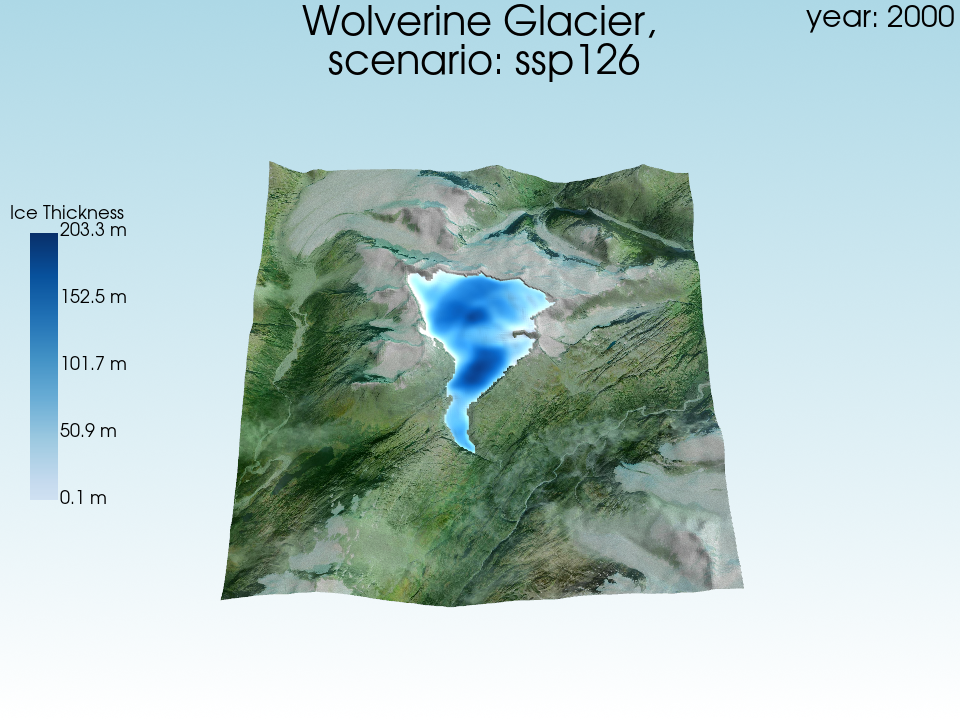

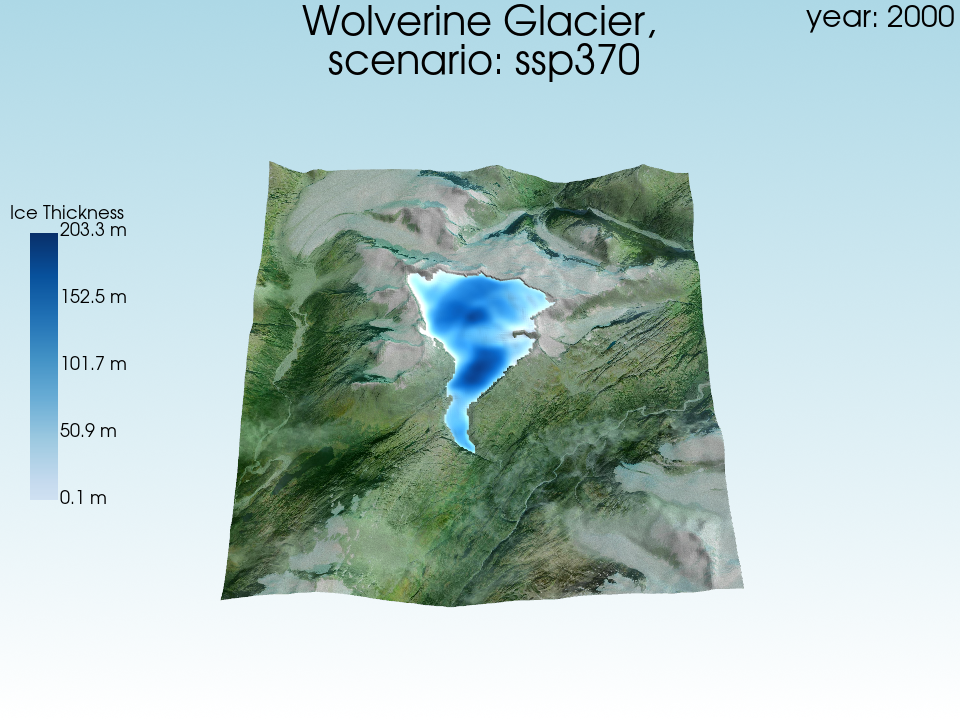

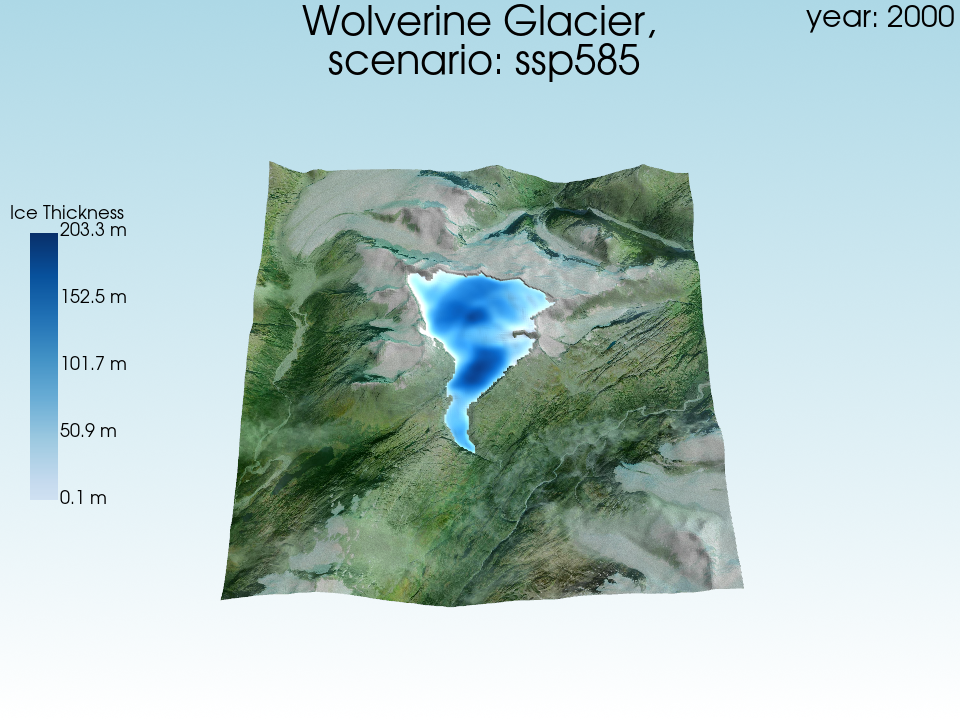

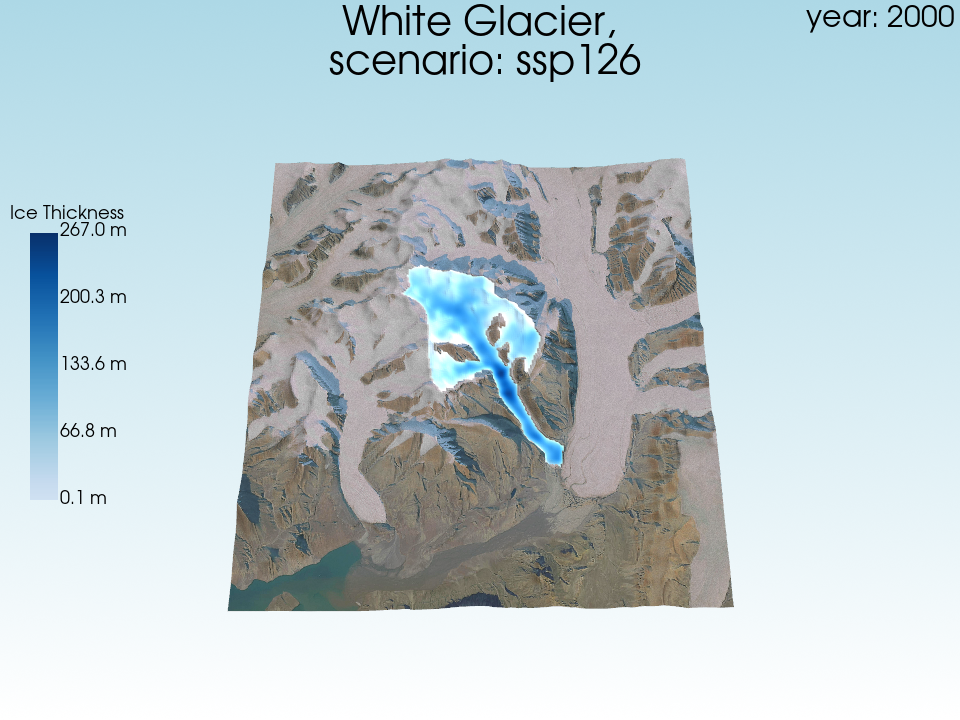

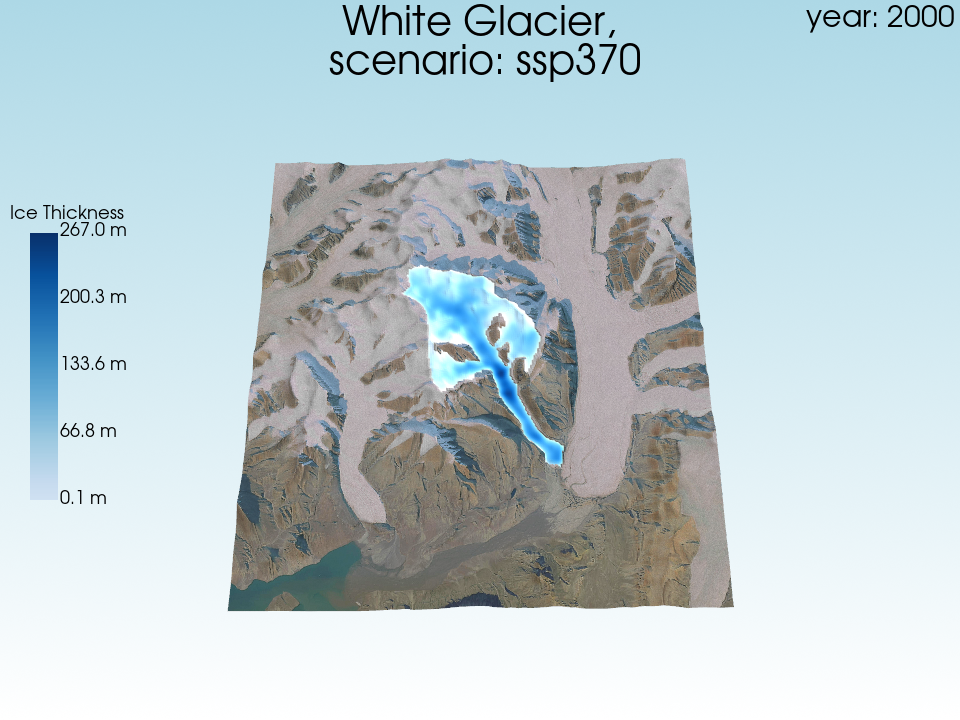

...

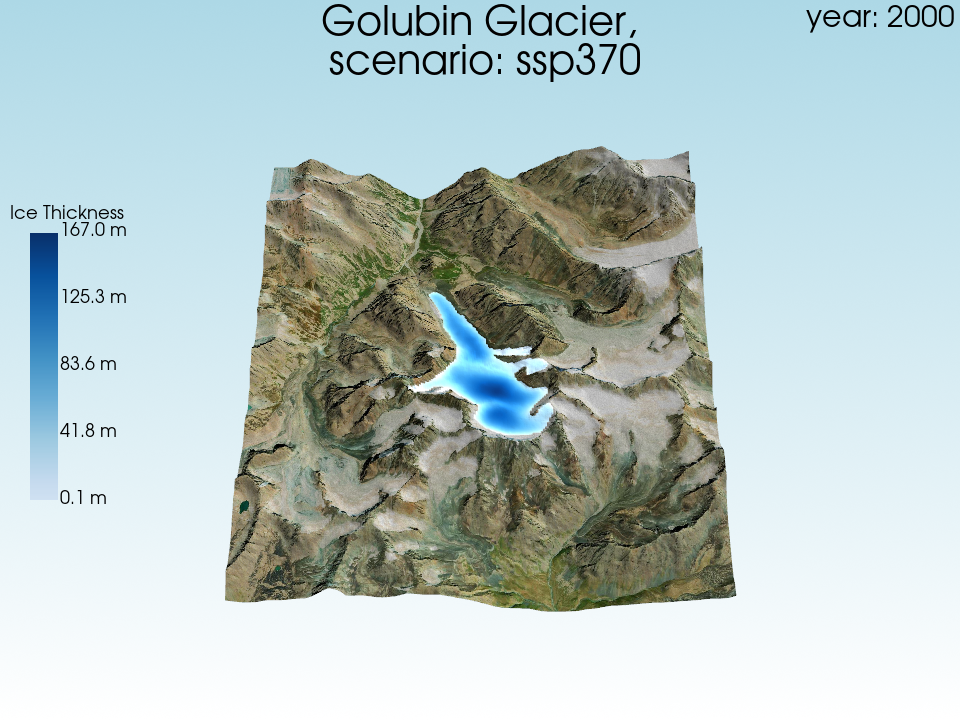

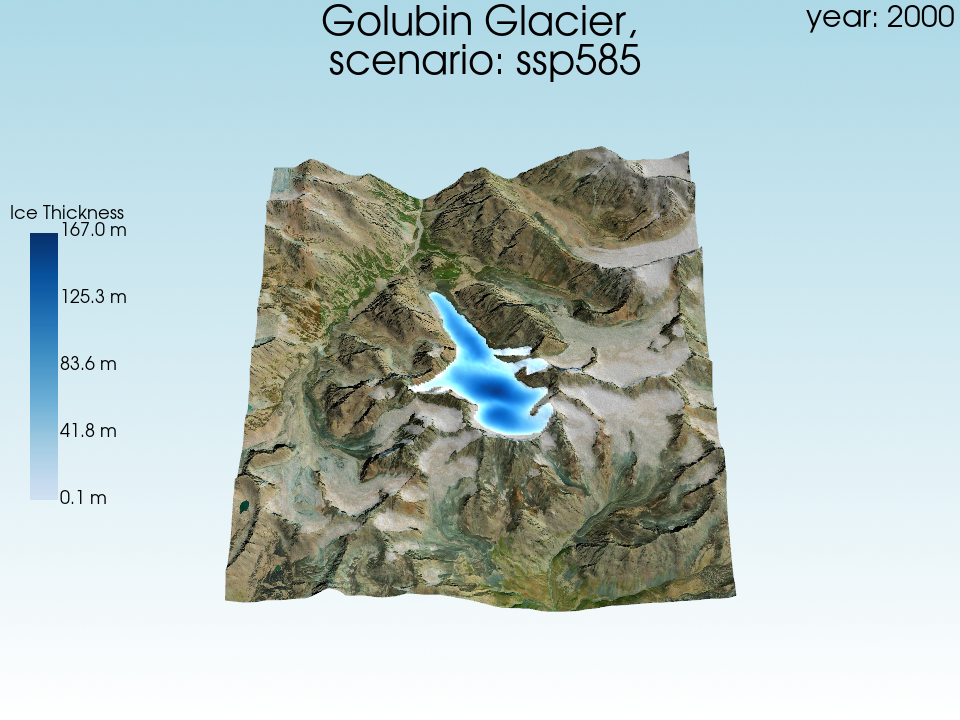

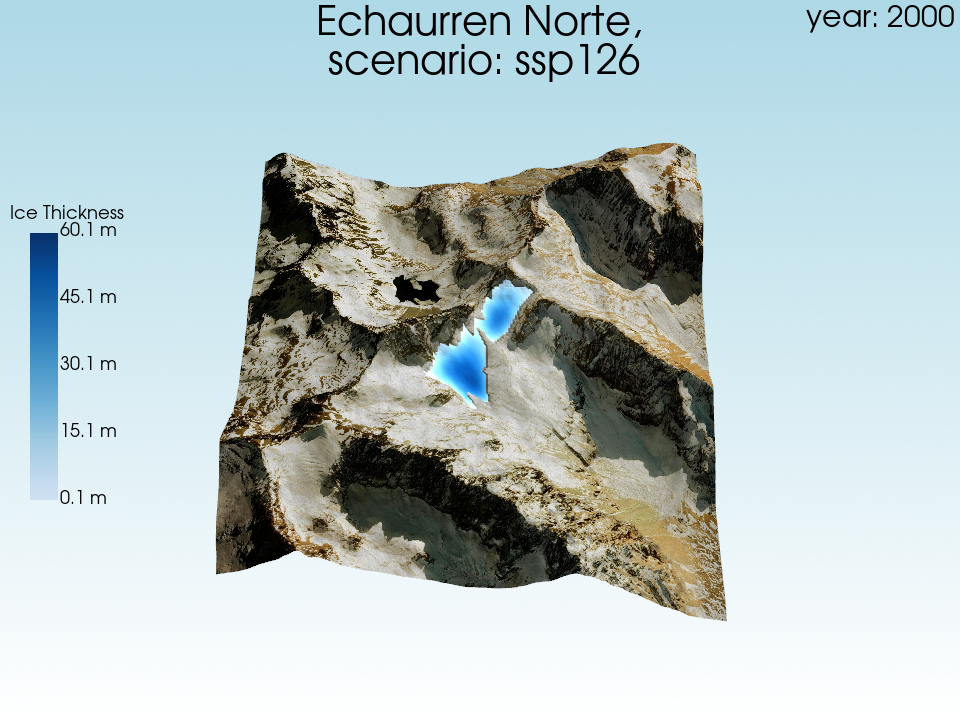

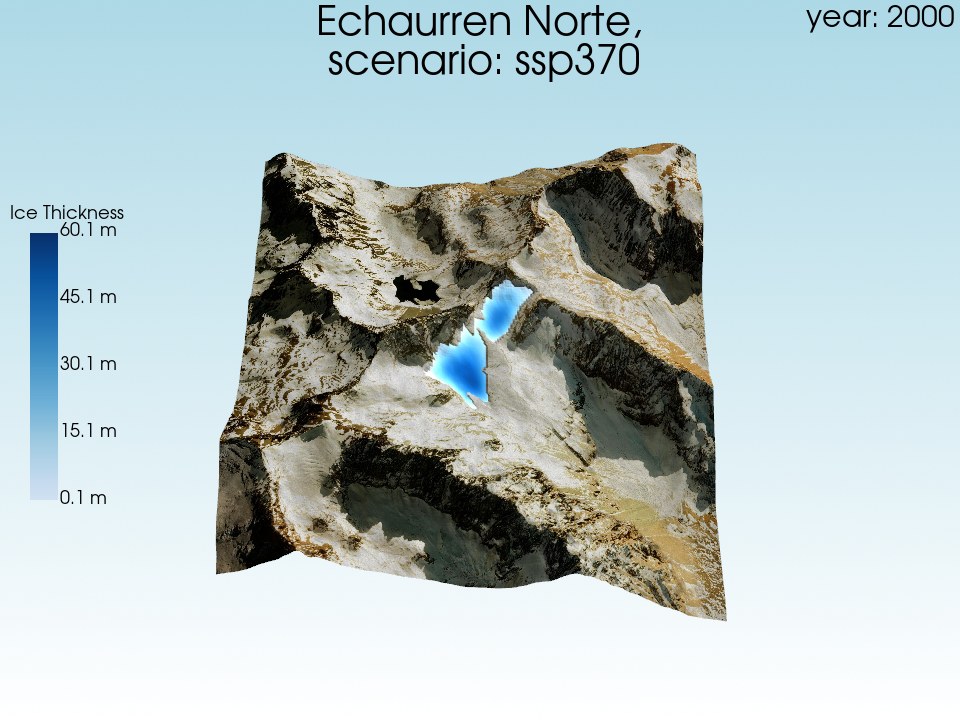

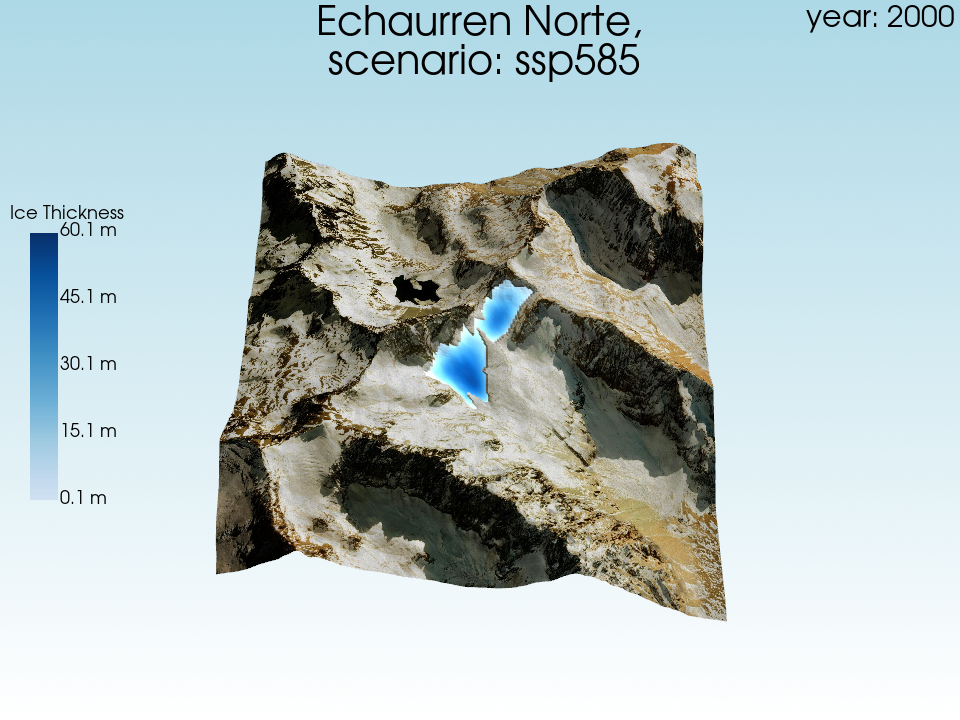

KeyboardInterrupt: 

In [24]:
from oggm.sandbox import distribute_2d
from oggm_3dviz.tools import Glacier3DViz
from oggm_3dviz.tools.map_annotations import TextAnnotation

# animations path
animations_path = join(cfg.PATHS['working_dir'], 'animations')
if not os.path.exists(animations_path):
    os.makedirs(animations_path)

for i, (glac_names, gdir) in enumerate(zip(glac_names, gdirs)):
    # This is to add a new topography to the file (smoothed differently)
    distribute_2d.add_smoothed_glacier_topo(gdir)
    # This is to get the bed map at the start of the simulation
    tasks.distribute_thickness_per_altitude(gdir)
    # This is to prepare the glacier directory for the interpolation (needs to be done only once)
    distribute_2d.assign_points_to_band(gdir)
    for ssp in ['ssp126', 'ssp370', 'ssp585']:
        rid = f'_ISIMIP3b_{member}_{ssp}'
        distribute_2d.distribute_thickness_from_simulation(gdir, input_filesuffix=rid, concat_input_filesuffix='_spinup_historical')
        with xr.open_dataset(gdir.get_filepath('gridded_simulation', filesuffix=f'_ISIMIP3b_{member}_{ssp}')) as ds:
            ds_glacier = ds.sel(time=slice(2000,2101))
            glac_name = gdir.name

            heading = TextAnnotation(
                text=f'{glac_name},\n scenario: {ssp}',
                position='upper_edge',
                font_size=16.5
                )
            
            viz = Glacier3DViz(
                ds_glacier,  # dataset for visualization
                x='x',  # x-coordinate name, default is 'x'
                y='y',  # y-coordinate name, default is 'y'
                time='time',  # time coordinate name, default is 'time'
                topo_bedrock='bedrock',  # bedrock data variable, default is 'bedrock'
                use_texture=True, # use satellite texture for the topography
                ice_thickness='simulated_thickness',  # evolving ice thickness variable, default is 'simulated_thickness'
                time_var_display='calendar_year',# time format displayed, opting for total years here
                camera_args={  # camera view settings, more details later
                    'azimuth': -135, # rotate around the z-axis
                    'elevation': 20,  # elevation angle above ground
                },
                additional_annotations=[heading]
                )
            viz.export_animation(filename=join(animations_path, f'{glac_name}_{ssp}.mp4'),  # filename for the animation, should end with .mp4
                     framerate=20,  # framerate of the animation, affects duration and speed
                     quality=5,  # The range is 0 - 10. Higher quality leads to a larger file.
                    )
            
        

In [13]:
ds_glacier = xr.open_dataset(gdir.get_filepath('gridded_simulation', filesuffix=f'_ISIMIP3b_{member}_ssp126'))


In [14]:
ds_glacier

<xarray.Dataset> Size: 31MB
Dimensions:              (y: 220, x: 210, time: 82)
Coordinates:
  * x                    (x) float32 840B -1.865e+03 -1.847e+03 ... 1.897e+03
  * y                    (y) float32 880B -3.714e+06 -3.714e+06 ... -3.718e+06
  * time                 (time) float64 656B 2.02e+03 2.021e+03 ... 2.101e+03
    calendar_year        (time) int64 656B ...
    calendar_month       (time) int64 656B ...
Data variables:
    glacier_mask         (y, x) int8 46kB ...
    topo                 (y, x) float32 185kB ...
    bedrock              (y, x) float32 185kB ...
    simulated_thickness  (time, y, x) float64 30MB ...
Attributes:
    author:         OGGM
    author_info:    Open Global Glacier Model
    pyproj_srs:     +proj=tmerc +lat_0=0 +lon_0=-70.1338 +k=0.9996 +x_0=0 +y_...
    max_h_dem:      4178.0
    min_h_dem:      2867.0
    max_h_glacier:  3889.0
    min_h_glacier:  3618.0

In [42]:
gdirs[1].rgi_region_name

'03: Arctic Canada North'

In [15]:
from oggm_3dviz.tools import Glacier3DViz
viz = Glacier3DViz(
    ds_glacier,  # dataset for visualization
    x='x',  # x-coordinate name, default is 'x'
    y='y',  # y-coordinate name, default is 'y'
    time='time',  # time coordinate name, default is 'time'
    topo_bedrock='bedrock',  # bedrock data variable, default is 'bedrock'
    ice_thickness='simulated_thickness',  # evolving ice thickness variable, default is 'simulated_thickness'
    time_var_display='calendar_year',  # time format displayed, opting for total years here
    camera_args={  # camera view settings, more details later
        'azimuth': -135, # rotate around the z-axis
        'elevation': 20,  # elevation angle above ground
    }
)

In [16]:
viz.show()

In [37]:
with xr.open_dataset(gdirs[0].get_filepath('gridded_simulation', filesuffix=f'_ISIMIP3b_{member}_ssp126')) as ds:
            ds_glacier = ds
            glac_name = gdir.name
            viz = Glacier3DViz(
                ds_glacier,  # dataset for visualization
                x='x',  # x-coordinate name, default is 'x'
                y='y',  # y-coordinate name, default is 'y'
                time='time',  # time coordinate name, default is 'time'
                topo_bedrock='bedrock',  # bedrock data variable, default is 'bedrock'
                ice_thickness='simulated_thickness',  # evolving ice thickness variable, default is 'simulated_thickness'
                use_texture=True,
                time_var_display='calendar_year',  # time format displayed, opting for total years here
                camera_args={  # camera view settings, more details later
                    'azimuth': -135, # rotate around the z-axis
                    'elevation': 20,  # elevation angle above ground
                }
                )
            viz.show()

In [38]:
viz.show()

## Plot model output 

In [ ]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 4))
# Pick some colors for the lines
color_dict={'ssp126':'blue', 'ssp370':'orange', 'ssp585':'red'}
for ssp in ['ssp126','ssp370', 'ssp585']:
    rid = f'_ISIMIP3b_{member}_{ssp}'
    # Compile the output into one file
    ds = utils.compile_run_output(gdirs, input_filesuffix=rid)
    # Plot it
    ds.isel(rgi_id=3).volume.plot(ax=ax1, label=ssp, c=color_dict[ssp]);
    ds.isel(rgi_id=4).volume.plot(ax=ax2, label=ssp, c=color_dict[ssp]);
plt.legend();

**That's it! Your OGGM projection in 10 minutes.**

## Have 5 minutes more? Download and process GCM data from CMIP5 or CMIP6

ISIMIP data is very useful because it is bias corrected. Furthermore, it offers daily data (which we will soon make available in OGGM).

But you may want a higher diversity of models or scenarios: for this, you may also use the CMIP5 or CMIP6 GCMs directly. These need to be bias-corrected first to the applied baseline climate (see [process_gcm_data](https://docs.oggm.org/en/stable/generated/oggm.tasks.process_gcm_data.html#oggm.shop.gcm_climate.process_gcm_data)). This relatively simple bias-correction is automatically done by `process_cmip_data` and is very important, as the model is very sensitive to temperature variability (see the following [blogpost](https://oggm.org/2021/08/05/mean-forcing/) for more details).
- CMIP5 has 4 different RCP scenarios and a variety of GCMs, online you can find them [here](https://cluster.klima.uni-bremen.de/~oggm/cmip5-ng). The above mentioned storage contains information about the data, [how to cite them](https://cluster.klima.uni-bremen.de/~oggm/cmip5-ng/README) and [tabular summaries](https://cluster.klima.uni-bremen.de/~oggm/cmip5-ng/all_gcm_table.html) of the available GCMs. 
- CMIP6 has 4 different SSP scenarios, see [this table](https://cluster.klima.uni-bremen.de/~oggm/cmip6/all_gcm_table.html) for a summary of available GCMs. There are even some CMIP6 runs that go until [2300](https://cluster.klima.uni-bremen.de/~oggm/cmip6/gcm_table_2300.html).

> Note, that the CMIP5 and CMIP6 files are much larger than the ISIMIP3b files. This is because we use a simple processing trick for the ISIMIP3b GCM files as we only save the glacier gridpoints, instead of  each longitude and latitude. 

**Therefore: run the following code only if it is ok to download a few gigabytes of data.** Set the variable below to true to run it. 

In [ ]:
download_cmip5_data = False

In [ ]:
if download_cmip5_data:

    bp = 'https://cluster.klima.uni-bremen.de/~oggm/cmip5-ng/pr/pr_mon_CCSM4_{}_r1i1p1_g025.nc'
    bt = 'https://cluster.klima.uni-bremen.de/~oggm/cmip5-ng/tas/tas_mon_CCSM4_{}_r1i1p1_g025.nc'

    color_dict_rcp={'rcp26':'blue', 'rcp45':'violet', 'rcp85':'red'}

    # Download and bias correct the data
    for rcp in ['rcp26', 'rcp45', 'rcp85']: # 'rcp60' would also be available
        # Download the files
        ft = utils.file_downloader(bt.format(rcp))
        fp = utils.file_downloader(bp.format(rcp))
        # bias correct them
        workflow.execute_entity_task(gcm_climate.process_cmip_data, gdirs, 
                                     filesuffix='_CMIP5_CCSM4_{}'.format(rcp),  # recognize the climate file for later
                                     fpath_temp=ft,  # temperature projections
                                     fpath_precip=fp,  # precip projections
                                     );

    # Run OGGM
    for rcp in ['rcp26', 'rcp45',  'rcp85']: #'rcp60',
        rid = '_CMIP5_CCSM4_{}'.format(rcp)
        workflow.execute_entity_task(tasks.run_from_climate_data, gdirs, ys=2020, 
                                     climate_filename='gcm_data',  # use gcm_data, not climate_historical
                                     climate_input_filesuffix=rid,  # use the chosen scenario
                                     init_model_filesuffix='_historical',  # this is important! Start from 2020 glacier
                                     output_filesuffix=rid,  # recognize the run for later
                                    );

    # Plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 4))
    for rcp in ['rcp26', 'rcp45', 'rcp85']: #'rcp60',
        rid = '_CMIP5_CCSM4_{}'.format(rcp)
        ds = utils.compile_run_output(gdirs, input_filesuffix=rid)
        ds.isel(rgi_id=0).volume.plot(ax=ax1, label=rcp, c=color_dict_rcp[rcp]);
        ds.isel(rgi_id=1).volume.plot(ax=ax2, label=rcp, c=color_dict_rcp[rcp]);
    plt.legend();

Now, the same for CMIP6 but instead of RCPs, now SSPs and again with another GCM:

(**Attention! This may take some time ...**) Set the variable below to true to run it.

In [ ]:
download_cmip6_data = False

In [ ]:
if download_cmip6_data:
    bp = 'https://cluster.klima.uni-bremen.de/~oggm/cmip6/GCM/CESM2/CESM2_{}_r1i1p1f1_pr.nc'
    bt = 'https://cluster.klima.uni-bremen.de/~oggm/cmip6/GCM/CESM2/CESM2_{}_r1i1p1f1_tas.nc'

    # Download and bias correct the data
    for ssp in ['ssp126', 'ssp585']:  # Removed 'ssp245', 'ssp370' because the files are large!
        # Download the files
        ft = utils.file_downloader(bt.format(ssp))
        fp = utils.file_downloader(bp.format(ssp))
        # bias correct them
        workflow.execute_entity_task(gcm_climate.process_cmip_data, gdirs, 
                                     #year_range=('1979', '2014'),
                                     filesuffix='_CMIP6_CESM2_{}'.format(ssp),  # recognize the climate file for later
                                     fpath_temp=ft,  # temperature projections
                                     fpath_precip=fp,  # precip projections
                                     );

    # Run OGGM
    for ssp in ['ssp126', 'ssp585']:
        rid = '_CMIP6_CESM2_{}'.format(ssp)
        workflow.execute_entity_task(tasks.run_from_climate_data, gdirs, ys=2020, 
                                     climate_filename='gcm_data',  # use gcm_data, not climate_historical
                                     climate_input_filesuffix=rid,  # use the chosen scenario
                                     init_model_filesuffix='_historical',  # this is important! Start from 2020 glacier
                                     output_filesuffix=rid,  # recognize the run for later
                                    );

    # Plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 4))
    for ssp in ['ssp126', 'ssp585']:
        rid = '_CMIP6_CESM2_{}'.format(ssp)
        ds = utils.compile_run_output(gdirs, input_filesuffix=rid)
        ds.isel(rgi_id=0).volume.plot(ax=ax1, label=ssp, c=color_dict[ssp]);
        ds.isel(rgi_id=1).volume.plot(ax=ax2, label=ssp, c=color_dict[ssp]);

    plt.legend();

## What's next?

- checkout the 10 mins tutorial on the [dynamical spinup](dynamical_spinup.ipynb)
- see also the tutorial on [Merge, analyse and visualize OGGM GCM runs](../advanced/merge_gcm_runs_and_visualize.ipynb)
- return to the [OGGM documentation](https://docs.oggm.org)
- back to the [table of contents](../welcome.ipynb)